## 1. Setup

### 1.1 Load the environment

In [2]:
%env MUJOCO_GL=egl
%env LD_LIBRARY_PATH=$LD_LIBRARY_PATH:/home/daniel/.mujoco/mujoco200/bin

from collections import namedtuple
from metaworld.envs import ALL_V2_ENVIRONMENTS_GOAL_OBSERVABLE

env_name = "drawer-open-v2-goal-observable"
env_cls = ALL_V2_ENVIRONMENTS_GOAL_OBSERVABLE[env_name]
e  = ALL_V2_ENVIRONMENTS_GOAL_OBSERVABLE[env_name](render_mode="rgb_array")

e.width = 256
e.height = 256
e.camera_name = "top_cap2"
# e.mujoco_renderer.width = 256
# e.mujoco_renderer.height = 256
e._freeze_rand_vec = False
e.spec = namedtuple('spec', ['id', 'max_episode_steps'])
e.spec.id = env_name
e.spec.max_episode_steps = 500
e.model.vis.global_.offwidth = 256
e.model.vis.global_.offheight = 256
e.reset()




env: MUJOCO_GL=egl
env: LD_LIBRARY_PATH=$LD_LIBRARY_PATH:/home/daniel/.mujoco/mujoco200/bin
Import error. Trying to rebuild mujoco_py.
Compiling /home/daniel/lfv-gen/.venv/lib/python3.10/site-packages/mujoco_py/cymj.pyx because it depends on /home/daniel/lfv-gen/.venv/lib/python3.10/site-packages/mujoco_py/pxd/mujoco.pxd.
[1/1] Cythonizing /home/daniel/lfv-gen/.venv/lib/python3.10/site-packages/mujoco_py/cymj.pyx


ImportError: libmujoco200.so: cannot open shared object file: No such file or directory

Inspect visual appearance

(256, 256, 3)


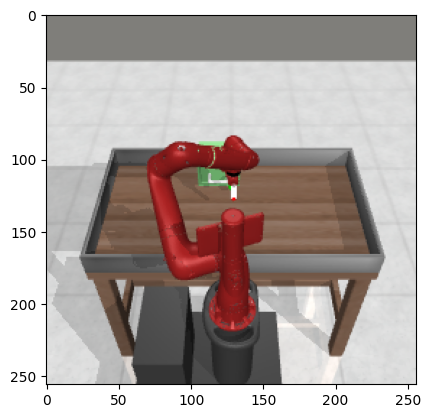

In [36]:
import matplotlib.pyplot as plt
import numpy as np

image = e.render()
print(image.shape)
plt.imshow(image)


### 1.2 Load the dataset

The dataset contains both `observations` (proprioceptive state) and `images` (pixel observations). 

In [3]:
import pickle
with open("/home/daniel/.datasets/drawer-open-v2-goal-observable.pickle", "rb") as f:
    episodes = pickle.load(f)


In [4]:
print("Number of episodes: ", len(episodes))
print(episodes[0].keys())

for k in episodes[0]:
    if k == "env_infos":
        pass
        # print(k, episodes[0]["env_infos"])
    else:
        print(k, episodes[0][k].shape)


Number of episodes:  200
dict_keys(['observations', 'actions', 'rewards', 'env_infos', 'images'])
observations (500, 39)
actions (500, 4)
rewards (500,)
images (500, 256, 256, 3)


Inspect the images in the dataset

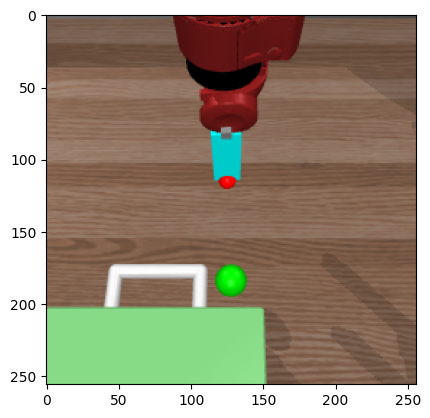

In [31]:
plt.imshow(episodes[0]["images"][0])

Record a video of one dataset trajectory

MoviePy - Building file output.gif with imageio.


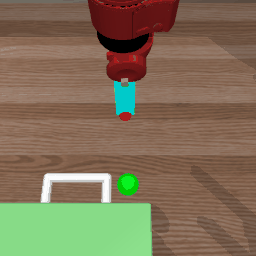

In [34]:
import numpy as np
from moviepy.editor import ImageSequenceClip
from IPython.display import Image, display

def make_gif(image_array, gif_path, fps=10):
    """
    Convert a numpy array of images to a GIF.

    Parameters:
    image_array (numpy.ndarray): An array of images of shape (batch, height, width, channels).
    gif_path (str): Path to save the GIF.
    fps (int): Frames per second in the GIF.
    """
    # Convert the numpy array to a list of images
    images = [img for img in image_array]
    
    # Create a moviepy clip
    clip = ImageSequenceClip(images, fps=fps)
    
    # Write the GIF file
    clip.write_gif(gif_path)

make_gif(episodes[0]["images"], "output.gif", fps=10)
gif_path = 'output.gif'
display(Image(filename=gif_path))


### 1.3 Load some other libraries

In [5]:
import haiku as hk
import jax
import jax.numpy as jnp
import tensorflow as tf

2024-01-20 18:20:51.938925: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-20 18:20:51.938953: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-20 18:20:51.940035: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-01-20 18:20:52.617551: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


## 2. State Experiment

Run BC experiment on Metaworld-states


In [6]:
import optax

def create_dataset(episodes):
    obs = []
    actions = []
    for episode in episodes:
        obs.append(episode["observations"])
        actions.append(episode["actions"])
    obs = np.concatenate(obs)
    actions = np.concatenate(actions)
    return tf.data.Dataset.from_tensor_slices((obs, actions))

def _forward_fn(obs):
    return hk.Sequential(
        [
            hk.LayerNorm(axis=-1, create_scale=True, create_offset=True),
            jnp.tanh,
            hk.nets.MLP(output_sizes=[256, 256, 4], activate_final=False),
        ]
    )(obs)


dataset_iterator = (
    create_dataset(episodes)
    .shuffle(int(1e6), reshuffle_each_iteration=True)
    .repeat()
    .batch(256)
    .repeat()
    .as_numpy_iterator()
)

model = hk.without_apply_rng(hk.transform(_forward_fn))
params = model.init(jax.random.PRNGKey(42), jnp.zeros((1, 39)))


optimizer = optax.adam(3e-4)
opt_state = optimizer.init(params)


def loss_fn(params, batch):
    obs, act = batch
    predicted_actions = model.apply(params, obs)
    return jnp.mean(jnp.square(predicted_actions - act))


@jax.jit
def train_step(params, opt_state, batch):
    loss, grads = jax.value_and_grad(loss_fn)(params, batch)
    updates, opt_state = optimizer.update(grads, opt_state, params)
    params = optax.apply_updates(params, updates)
    return params, opt_state, loss


for step in range(10000):
    params, opt_state, loss = train_step(params, opt_state, next(dataset_iterator))
    if step % 1000 == 0:
        print(step, "loss", jax.device_get(loss))

2024-01-20 18:20:57.453731: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2256] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...
An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


0 loss 0.85490763
1000 loss 0.027167726
2000 loss 0.020306252
3000 loss 0.013866151
4000 loss 0.016874723
5000 loss 0.00467459
6000 loss 0.010110191
7000 loss 0.013262697
8000 loss 0.009026635
9000 loss 0.006456224


In [7]:
print(e.metadata)

{'render_modes': ['human', 'rgb_array', 'depth_array'], 'render_fps': 80}


In [9]:
@jax.jit
def policy(params, obs):
    return model.apply(params, obs)

eval_env = RecordVideo(e, 'state_expt_videos', episode_trigger=lambda x: True, video_length=500, name_prefix="drawer-open-v2-goal-observable")
for _ in range(10):

    episode_return = 0
    obs, info = eval_env.reset()
    while True:
        action = policy(params, obs[None, ...])
        obs, reward, terminated, truncated, info = eval_env.step(np.asarray(action[0]))
        if terminated or truncated:
            print(info["success"], )
            break

Moviepy - Building video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-0.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-0.mp4
1.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-1.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-1.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-1.mp4
1.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-2.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-2.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-2.mp4
1.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-3.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-3.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-3.mp4
1.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-4.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-4.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-4.mp4
1.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-5.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-5.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-5.mp4
1.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-6.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-6.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-6.mp4
1.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-7.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-7.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-7.mp4
1.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-8.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-8.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-8.mp4
1.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-9.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-9.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/state_expt_videos/drawer-open-v2-goal-observable-episode-9.mp4
1.0


## Pixel Experiment


### 3.1 Preprocess image dataset

We preprocess the dataset to add the R3M representations.


In [16]:
resnet_size = 18
model_name ="r3m-18"

# Because we're using our own model, check that the hash matches
r3m_filepath = f"/home/daniel/jam/data/models/r3m/{model_name}/torch_model.pt"
import hashlib
from jam.model_zoo import MODEL_URLS
with open(r3m_filepath, "rb") as f:
    r3m_bytes = f.read()
    r3m_hash = hashlib.md5(r3m_bytes).hexdigest()

assert r3m_hash == MODEL_URLS[f"r3m/{model_name}"]["ckpt_md5"], "Hashes do not match"

In [10]:
from safetensors.flax import load_file
from jam.haiku import r3m
from jam import imagenet_util

import optax
import tqdm

def r3m_forward(inputs, is_training=True):
    model = r3m.R3M(resnet_size)
    return model(inputs, is_training)

r3m_model = hk.without_apply_rng(hk.transform_with_state(r3m_forward))

state_dict = load_file(f"/home/daniel/jam/data/models/r3m/{model_name}/torch_model.safetensors")
r3m_params, r3m_state = r3m.load_from_torch_checkpoint(state_dict)

# r3m_model.apply(r3m_params, r3m_state, jnp.zeros((1, 256, 256, 3)), is_training=False)[0].shape

@jax.jit
def preprocess_image(params, state, images):
    assert images.dtype == jnp.uint8
    images = (images.astype(jnp.float32) - np.asarray(imagenet_util.IMAGENET_MEAN_RGB)) / np.asarray(imagenet_util.IMAGENET_STDDEV_RGB)
    return r3m_model.apply(params, state, images, is_training=False)[0]

def create_dataset(episodes):
    obs = []
    actions = []
    for episode in tqdm.tqdm(episodes, desc="Preprocessing images"):
        images = episode["images"]
        embeddings = jax.device_get(preprocess_image(r3m_params, r3m_state, images))
        obs.append(embeddings)
        actions.append(episode["actions"])
    obs = np.concatenate(obs)
    actions = np.concatenate(actions)
    return tf.data.Dataset.from_tensor_slices((obs, actions))

dataset = create_dataset(episodes)


Preprocessing images: 100%|██████████| 200/200 [07:32<00:00,  2.26s/it]


In [21]:
import pickle 
dataset.save(f"{model_name}-pixels-dataset", compression='GZIP')

# test loading
dataset = tf.data.Dataset.load(f"{model_name}-pixels-dataset", compression='GZIP')

In [26]:
_obs, _act = next(iter(dataset))
print(_obs.shape, _act.shape)

(512,) (4,)


### 3.2 Train imitation learning policy

In [27]:
def _forward_fn(obs):
    return hk.Sequential(
        [
            hk.LayerNorm(axis=-1, create_scale=True, create_offset=True),
            jnp.tanh,
            hk.nets.MLP(output_sizes=[256, 256, 4], activate_final=False),
        ]
    )(obs)


model = hk.without_apply_rng(hk.transform(_forward_fn))
params = model.init(jax.random.PRNGKey(42), jnp.zeros((1, 512)))


optimizer = optax.adam(3e-4)
opt_state = optimizer.init(params)


def loss_fn(params, batch):
    obs, act = batch
    predicted_actions = model.apply(params, obs)
    return jnp.mean(jnp.square(predicted_actions - act))


@jax.jit
def train_step(params, opt_state, batch):
    loss, grads = jax.value_and_grad(loss_fn)(params, batch)
    updates, opt_state = optimizer.update(grads, opt_state, params)
    params = optax.apply_updates(params, updates)
    return params, opt_state, loss

dataset_iterator = (
    dataset
    .shuffle(int(1e6), reshuffle_each_iteration=True)
    .repeat()
    .batch(256)
    .repeat()
    .as_numpy_iterator()
)

loss_hist = []
for step in range(10000):
    params, opt_state, loss = train_step(params, opt_state, next(dataset_iterator))
    if step % 1000 == 0:
        loss_hist.append(loss)
        print(step, "loss", jax.device_get(loss))

0 loss 0.8784656
1000 loss 0.010620366
2000 loss 0.011765063
3000 loss 0.010826627
4000 loss 0.006281581
5000 loss 0.0018207263
6000 loss 0.0048541157
7000 loss 0.0017856527
8000 loss 0.0016628356
9000 loss 0.0011800197


Text(0.5, 1.0, 'Loss')

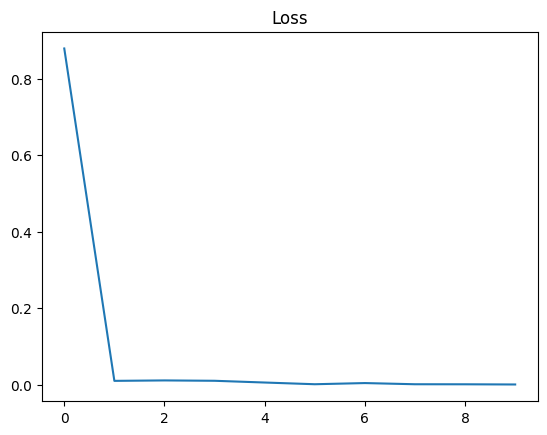

In [29]:
plt.plot(loss_hist)
plt.title("Loss")


In [30]:
@jax.jit
def policy(params, obs):
    return model.apply(params, obs)

eval_env = RecordVideo(e, 'pixel_expt_videos', episode_trigger=lambda x: True, video_length=500, name_prefix="drawer-open-v2-goal-observable")
for _ in range(10):
    episode_return = 0
    obs, info = eval_env.reset()
    image = eval_env.render()

    while True:
        action = policy(params, preprocess_image(r3m_params, r3m_state, image[None, ...]))
        obs, reward, terminated, truncated, info = eval_env.step(np.asarray(action[0]))
        image = eval_env.render()
        if terminated or truncated:
            print(info["success"], )
            break

/home/daniel/lfv-gen/.venv/lib/python3.10/site-packages/gymnasium/wrappers/record_video.py:94: UserWarning: WARN: Overwriting existing videos at /home/daniel/lfv-gen/notebooks/pixel_expt_videos folder (try specifying a different `video_folder` for the `RecordVideo` wrapper if this is not desired)
  logger.warn(


Moviepy - Building video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-0.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-0.mp4
0.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-1.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-1.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-1.mp4
0.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-2.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-2.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-2.mp4
0.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-3.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-3.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-3.mp4
0.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-4.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-4.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-4.mp4
0.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-5.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-5.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-5.mp4
0.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-6.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-6.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-6.mp4
0.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-7.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-7.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-7.mp4
0.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-8.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-8.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-8.mp4
0.0
Moviepy - Building video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-9.mp4.
Moviepy - Writing video /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-9.mp4



Moviepy - Done !
Moviepy - video ready /home/daniel/lfv-gen/notebooks/pixel_expt_videos/drawer-open-v2-goal-observable-episode-9.mp4
0.0
